In [1]:
import pickle
import matplotlib.pyplot as plt
from glob import glob
import cv2
import os
import math

In [2]:

with open('clsdict.pickle', 'rb') as fr:
    clsdict = pickle.load(fr)

In [3]:
clsdict

{1: [['../../../datasets/aihub_safety/human_car_ver2/labels/S2-N0508M47833.txt',
   91,
   70,
   119,
   0.5882352941176471],
  ['../../../datasets/aihub_safety/human_car_ver2/labels/S2-N0508M47833.txt',
   68,
   61,
   75,
   0.8133333333333334],
  ['../../../datasets/aihub_safety/human_car_ver2/labels/S2-N0508M47833.txt',
   41,
   26,
   65,
   0.4],
  ['../../../datasets/aihub_safety/human_car_ver2/labels/S2-N0508M47833.txt',
   138,
   99,
   192,
   0.515625],
  ['../../../datasets/aihub_safety/human_car_ver2/labels/S2-N0508M47833.txt',
   104,
   68,
   159,
   0.4276729559748428],
  ['../../../datasets/aihub_safety/human_car_ver2/labels/S2-N0508M47833.txt',
   42,
   37,
   48,
   0.7708333333333334],
  ['../../../datasets/aihub_safety/human_car_ver2/labels/S2-N0508M47833.txt',
   82,
   63,
   106,
   0.5943396226415094],
  ['../../../datasets/aihub_safety/human_car_ver2/labels/S2-N0508M36428.txt',
   245,
   250,
   240,
   1.0416666666666667],
  ['../../../datasets/aihub_s

In [4]:

labels1 = glob('../../../datasets/aihub_safety/train/*/*/*/*.json')
labels2 = glob('../../../datasets/aihub_safety/train/*/*/*.json')
labels = labels1 + labels2

images = glob('../../datasets/aihub_safety/train/*/*.jpg')

In [5]:
import pandas as pd

list01 = []
for i in clsdict.keys():
    for j in clsdict[i]:
        list01.append([i] + j)
        
df = pd.DataFrame(list01, columns=['cls','path','resolution','width','height','wperh'])

In [6]:
from tqdm import tqdm
import os
list02 = []
for i in tqdm(range(len(df))):
    df.loc[i,'path'] = (os.path.basename(df.loc[i,'path']))

100%|██████████| 5216750/5216750 [02:23<00:00, 36412.10it/s]


In [7]:
df

,cls,path,resolution,width,height,wperh
0,1,S2-N0508M47833.txt,91,70,119,0.588235
1,1,S2-N0508M47833.txt,68,61,75,0.813333
2,1,S2-N0508M47833.txt,41,26,65,0.400000
3,1,S2-N0508M47833.txt,138,99,192,0.515625
4,1,S2-N0508M47833.txt,104,68,159,0.427673
...,...,...,...,...,...,...
5216745,19,S2-N2105M41828.txt,800,1060,604,1.754967
5216746,19,S2-N2103M71858.txt,709,1207,416,2.901442
5216747,19,S2-N2103M57265.txt,502,680,370,1.837838
5216748,19,S2-N2105M46001.txt,630,949,418,2.270335


In [8]:
from multiprocessing import Process

def start_get(start,end):
    total = 0
    for i in range(start,end):
        total += i
    print(total)

if __name__ == '__main__':
    # 프로세스를 생성 합니다.
    p0 = Process(target = start_get, args = (0,100000000))
    p1 = Process(target = start_get, args = (100000001,200000000))
    p2 = Process(target = start_get, args = (200000001,300000000))

    # 프로세스의 시작

    p0.start()
    p1.start()
    p2.start()

    # 순서를 정리 : 다른 프로세스가 종료될 때 까지 대기

    p0.join()
    p1.join()
    p2.join()

    print(">>>>END<<<<<") # 37.46에서 7.79초로 줄음

14999999850000000
24999999750000000
4999999950000000
>>>>END<<<<<


In [30]:
def multi_pro1(index1,index2,results,j):
    global df,labels 

    tmp_labels = labels[index1:index2]
    des_path = '../../../datasets/aihub_safety/human_car_ver2/labels/'

    path_dict = {}

    for i in tqdm(tmp_labels):
        if os.path.exists(des_path + os.path.basename(i)[:-4] + 'txt'):
            path_dict[os.path.basename(i)[:-4] + 'txt'] = i


            # i.split('train/')
    results[j] = path_dict

# print('adasa')

In [31]:

x =list(range(0, len(labels), len(labels)//10))

x[-1] = len(labels)

In [32]:
x

[0,
 230463,
 460926,
 691389,
 921852,
 1152315,
 1382778,
 1613241,
 1843704,
 2074167,
 2304631]

In [33]:
from threading import Thread

n = 10

p = [None] * n
results = [None] * n 
for i in range(n):
    p[i] = Thread(target = multi_pro1, args = (x[i],x[i+1], results,i))
    p[i].start()

for i in range(n):
    p[i].join()





  0%|          | 0/230463 [00:00<?, ?it/s]














































  2%|▏         | 3499/230463 [00:00<00:08, 26566.60it/s]
















































  3%|▎         | 6156/230463 [00:00<00:08, 25186.76it/s]































  4%|▍         | 9381/230463 [00:00<00:07, 28000.56it/s]
































































  5%|▌         | 12203/230463 [00:00<00:11, 18411.55it/s]























  6%|▌         | 14372/230463 [00:00<00:11, 18558.07it/s]


























  7%|▋         | 16442/230463 [00:00<00:11, 19039.73it/s]


































  8%|▊         | 18501/230463 [00:00<00:11, 19132.17it/s]



































  9%|▉         | 20830/230463 [00:01<00:10, 20229.42it/s]






















 10%|█         | 23076/230463 [00:01<00:09, 20844.70it/s]


































 11%|█         | 25228/230463 [00:01<00:10, 18776.40it/s]
















In [28]:
results

[{'path': ['S2-O1302M00698.txt',
   'S2-O1302M00024.txt',
   'S2-O1301M02099.txt',
   'S2-O1301M01370.txt',
   'S2-O1302M00337.txt',
   'S2-O1301M01261.txt',
   'S2-O1301M03854.txt',
   'S2-O1301M02736.txt',
   'S2-O1301M00323.txt',
   'S2-O1301M03811.txt',
   'S2-O1301M03449.txt',
   'S2-O1301M01252.txt',
   'S2-O1301M01228.txt',
   'S2-O1301M01671.txt',
   'S2-O1302M00224.txt',
   'S2-O1301M02673.txt',
   'S2-O1302M00275.txt',
   'S2-O1301M04348.txt',
   'S2-O1301M02563.txt',
   'S2-O1301M01405.txt',
   'S2-O1301M02597.txt',
   'S2-O1301M02062.txt',
   'S2-O1301M02358.txt',
   'S2-O1301M00667.txt',
   'S2-O1301M03658.txt',
   'S2-O1302M00357.txt',
   'S2-O1301M01859.txt',
   'S2-O1301M01291.txt',
   'S2-O1301M04243.txt',
   'S2-O1301M02408.txt',
   'S2-O1301M02658.txt',
   'S2-O1301M04439.txt',
   'S2-O1301M01609.txt',
   'S2-O1301M01639.txt',
   'S2-O1301M03481.txt',
   'S2-O1301M04344.txt',
   'S2-O1301M00282.txt',
   'S2-O1302M00340.txt',
   'S2-O1302M00602.txt',
   'S2-O1301M0372

In [35]:
a= {1 :2}
b = {3 :4 }
a.update(b)

{1: 2, 3: 4}

In [40]:
result = results[0]
for i in range(9):
    result.update(results[i+1])

    

In [42]:
len(result.keys())

925106

In [43]:
df

,cls,path,resolution,width,height,wperh
0,1,S2-N0508M47833.txt,91,70,119,0.588235
1,1,S2-N0508M47833.txt,68,61,75,0.813333
2,1,S2-N0508M47833.txt,41,26,65,0.400000
3,1,S2-N0508M47833.txt,138,99,192,0.515625
4,1,S2-N0508M47833.txt,104,68,159,0.427673
...,...,...,...,...,...,...
5216745,19,S2-N2105M41828.txt,800,1060,604,1.754967
5216746,19,S2-N2103M71858.txt,709,1207,416,2.901442
5216747,19,S2-N2103M57265.txt,502,680,370,1.837838
5216748,19,S2-N2105M46001.txt,630,949,418,2.270335


In [45]:
df.loc[1,'path']

'S2-N0508M47833.txt'

In [261]:
for i in tqdm(range(len(df))):
    df.loc[i,'origin_path'] = result[df.loc[i,'path']]

  0%|          | 16/5216750 [00:00<61:51:32, 23.43it/s]


KeyboardInterrupt: 

In [49]:
for i in tqdm(range(len(df))):
    df.loc[i,'origin_path'] = df.loc[i,'origin_path'].split('train/')[1]

100%|██████████| 5216750/5216750 [02:28<00:00, 35074.62it/s]


In [53]:
a = set()
a.add('b')

'c' in a

False

In [59]:
tmp_set = set()
path_count = {}
for i in tqdm(range(len(df))):
    o_path = os.path.dirname(os.path.dirname(df.loc[i,'origin_path']))
    if o_path not in tmp_set:
        tmp_set.add(o_path)
        path_count[o_path] = 1
    else:
        path_count[o_path] += 1
        
    

    

100%|██████████| 5216750/5216750 [00:21<00:00, 239185.64it/s]


In [61]:
path_count

{'[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사': 1806330,
 '[라벨]5.물류센터/인천공항 화물터미널E': 373094,
 '[라벨]6.상업시설/송도동': 307622,
 '[라벨]1.공동주택/서대문': 194750,
 '[라벨]4.공항시설/인천공항 제2여객터미널 증축공사(서측)': 965379,
 '[라벨]10.주차장/고양스타필드': 1078756,
 '[라벨]3.공장/가산동 A1타워 지식산업 센터': 221067,
 '[라벨]8.오피스/문정동 KG 사옥 신축공사': 85431,
 '[라벨]2.공연장/부산 오페라 하우스 신축공사': 10597,
 '[라벨]1.공동주택/주안 재건축': 15960,
 '[라벨]1.공동주택/송도호반': 85887,
 '[라벨]6.상업시설/신사동 복합 시설': 10583,
 '[라벨]5.물류센터/반도체 장비 클러스터 신축공사': 49952,
 '[라벨]1.공동주택/동탄': 726,
 '[라벨]7.스튜디오': 10616}

In [70]:
for i in tqdm(range(len(df))):
    df.loc[i,'origin_path'] = '/'.join(df.loc[i,'origin_path'].split('/')[:-2])

In [72]:
df

,cls,path,resolution,width,height,wperh,origin_path
0,1,S2-N0508M47833.txt,91,70,119,0.588235,[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사
1,1,S2-N0508M47833.txt,68,61,75,0.813333,[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사
2,1,S2-N0508M47833.txt,41,26,65,0.400000,[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사
3,1,S2-N0508M47833.txt,138,99,192,0.515625,[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사
4,1,S2-N0508M47833.txt,104,68,159,0.427673,[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사
...,...,...,...,...,...,...,...
5216745,19,S2-N2105M41828.txt,800,1060,604,1.754967,[라벨]10.주차장/고양스타필드
5216746,19,S2-N2103M71858.txt,709,1207,416,2.901442,[라벨]10.주차장/고양스타필드
5216747,19,S2-N2103M57265.txt,502,680,370,1.837838,[라벨]10.주차장/고양스타필드
5216748,19,S2-N2105M46001.txt,630,949,418,2.270335,[라벨]10.주차장/고양스타필드


In [74]:
tmp_set

{'[라벨]1.공동주택/동탄',
 '[라벨]1.공동주택/서대문',
 '[라벨]1.공동주택/송도호반',
 '[라벨]1.공동주택/주안 재건축',
 '[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사',
 '[라벨]10.주차장/고양스타필드',
 '[라벨]2.공연장/부산 오페라 하우스 신축공사',
 '[라벨]3.공장/가산동 A1타워 지식산업 센터',
 '[라벨]4.공항시설/인천공항 제2여객터미널 증축공사(서측)',
 '[라벨]5.물류센터/반도체 장비 클러스터 신축공사',
 '[라벨]5.물류센터/인천공항 화물터미널E',
 '[라벨]6.상업시설/송도동',
 '[라벨]6.상업시설/신사동 복합 시설',
 '[라벨]7.스튜디오',
 '[라벨]8.오피스/문정동 KG 사옥 신축공사'}

In [88]:
folder_list = list(df.loc[:,'origin_path'].value_counts().keys())

In [89]:
folder_list.sort()

In [90]:
folder_list

['[라벨]1.공동주택/동탄',
 '[라벨]1.공동주택/서대문',
 '[라벨]1.공동주택/송도호반',
 '[라벨]1.공동주택/주안 재건축',
 '[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사',
 '[라벨]10.주차장/고양스타필드',
 '[라벨]2.공연장/부산 오페라 하우스 신축공사',
 '[라벨]3.공장/가산동 A1타워 지식산업 센터',
 '[라벨]4.공항시설/인천공항 제2여객터미널 증축공사(서측)',
 '[라벨]5.물류센터/반도체 장비 클러스터 신축공사',
 '[라벨]5.물류센터/인천공항 화물터미널E',
 '[라벨]6.상업시설/송도동',
 '[라벨]6.상업시설/신사동 복합 시설',
 '[라벨]7.스튜디오',
 '[라벨]8.오피스/문정동 KG 사옥 신축공사']

0          False
1          False
2          False
3          False
4          False
           ...  
5216745    False
5216746    False
5216747    False
5216748    False
5216749    False
Length: 5216750, dtype: bool

In [112]:
df.loc[(df.loc[:,'cls'] == 7) & (df.loc[:,'origin_path'] == folder_list[0])].sort_values('path')

,cls,path,resolution,width,height,wperh,origin_path
3580863,7,S2-N0002M00003.txt,62,54,71,0.760563,[라벨]1.공동주택/동탄
3206187,7,S2-N0002M00005.txt,75,65,86,0.755814,[라벨]1.공동주택/동탄
3520049,7,S2-N0002M00138.txt,56,55,58,0.948276,[라벨]1.공동주택/동탄
4050402,7,S2-N0002M00162.txt,54,56,53,1.056604,[라벨]1.공동주택/동탄
3876968,7,S2-N0002M00164.txt,58,55,62,0.887097,[라벨]1.공동주택/동탄
...,...,...,...,...,...,...,...
3213944,7,S2-O0001M00367.txt,47,49,46,1.065217,[라벨]1.공동주택/동탄
3629353,7,S2-O0001M00368.txt,73,62,86,0.720930,[라벨]1.공동주택/동탄
3948803,7,S2-O0001M00404.txt,101,92,111,0.828829,[라벨]1.공동주택/동탄
3853866,7,S2-O0001M00405.txt,135,125,145,0.862069,[라벨]1.공동주택/동탄


In [109]:
folder_list

['[라벨]1.공동주택/동탄',
 '[라벨]1.공동주택/서대문',
 '[라벨]1.공동주택/송도호반',
 '[라벨]1.공동주택/주안 재건축',
 '[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사',
 '[라벨]10.주차장/고양스타필드',
 '[라벨]2.공연장/부산 오페라 하우스 신축공사',
 '[라벨]3.공장/가산동 A1타워 지식산업 센터',
 '[라벨]4.공항시설/인천공항 제2여객터미널 증축공사(서측)',
 '[라벨]5.물류센터/반도체 장비 클러스터 신축공사',
 '[라벨]5.물류센터/인천공항 화물터미널E',
 '[라벨]6.상업시설/송도동',
 '[라벨]6.상업시설/신사동 복합 시설',
 '[라벨]7.스튜디오',
 '[라벨]8.오피스/문정동 KG 사옥 신축공사']

In [241]:
cls_num = 7
folder_num = 0

checking_df = df.loc[(df.loc[:,'cls'] == 8) & (df.loc[:,'origin_path'] == folder_list[4])].sort_values('path')


S2-N0002M00221.txt    2
S2-N0002M00222.txt    2
S2-N0002M00003.txt    1
S2-O0001M00138.txt    1
S2-O0001M00124.txt    1
                     ..
S2-O0001M00034.txt    1
S2-O0001M00032.txt    1
S2-O0001M00030.txt    1
S2-O0001M00029.txt    1
S2-O0001M00406.txt    1
Name: path, Length: 139, dtype: int64

# 폴더별 라벨 체크 시작

In [158]:
def xywh2xyxy(xywh,w,h, rounding = True):
    xywh = [float(i) for i in xywh]

    if rounding:
        xyxy = [round((xywh[0] - xywh[2]/2) * w),round((xywh[1] - xywh[3]/2) * h),round((xywh[0] + xywh[2]/2) * w),round((xywh[1] + xywh[3]/2) * h)]
        if xyxy[0] > xyxy[2]:
            temp = xyxy[0]
            xyxy[0] = xyxy[2]
            xyxy[2] = temp
        if xyxy[1] > xyxy[3]:
            temp = xyxy[1]
            xyxy[1] = xyxy[3]
            xyxy[1] = temp
        return xyxy
    else:
        return [(xywh[0] - xywh[2]/2) * w ,(xywh[1] - xywh[3]/2) * h ,(xywh[0] + xywh[2]/2) * w ,(xywh[1] + xywh[3]/2) * h]


In [123]:
labels[45:]

array(['S2-O0001M00035.txt', 'S2-O0001M00036.txt', 'S2-O0001M00037.txt',
       'S2-O0001M00038.txt', 'S2-O0001M00039.txt', 'S2-O0001M00040.txt',
       'S2-O0001M00041.txt', 'S2-O0001M00042.txt', 'S2-O0001M00043.txt',
       'S2-O0001M00045.txt', 'S2-O0001M00046.txt', 'S2-O0001M00047.txt',
       'S2-O0001M00048.txt', 'S2-O0001M00051.txt', 'S2-O0001M00052.txt',
       'S2-O0001M00053.txt', 'S2-O0001M00054.txt', 'S2-O0001M00055.txt',
       'S2-O0001M00056.txt', 'S2-O0001M00058.txt', 'S2-O0001M00059.txt',
       'S2-O0001M00060.txt', 'S2-O0001M00061.txt', 'S2-O0001M00062.txt',
       'S2-O0001M00064.txt', 'S2-O0001M00071.txt', 'S2-O0001M00072.txt',
       'S2-O0001M00073.txt', 'S2-O0001M00074.txt', 'S2-O0001M00075.txt',
       'S2-O0001M00076.txt', 'S2-O0001M00094.txt', 'S2-O0001M00098.txt',
       'S2-O0001M00099.txt', 'S2-O0001M00100.txt', 'S2-O0001M00101.txt',
       'S2-O0001M00102.txt', 'S2-O0001M00114.txt', 'S2-O0001M00115.txt',
       'S2-O0001M00116.txt', 'S2-O0001M00117.txt', 

In [136]:

labels = checking_df.loc[:,'path'].values
labels.sort()

In [ ]:
i

In [137]:
labels.sort()

array(['S2-N0002M00003.txt', 'S2-N0002M00005.txt', 'S2-N0002M00138.txt',
       'S2-N0002M00162.txt', 'S2-N0002M00164.txt', 'S2-N0002M00204.txt',
       'S2-N0002M00205.txt', 'S2-N0002M00221.txt', 'S2-N0002M00221.txt',
       'S2-N0002M00222.txt', 'S2-N0002M00222.txt', 'S2-N0002M00223.txt',
       'S2-N0002M00224.txt', 'S2-N0002M00251.txt', 'S2-O0001M00001.txt',
       'S2-O0001M00002.txt', 'S2-O0001M00003.txt', 'S2-O0001M00004.txt',
       'S2-O0001M00005.txt', 'S2-O0001M00006.txt', 'S2-O0001M00007.txt',
       'S2-O0001M00008.txt', 'S2-O0001M00010.txt', 'S2-O0001M00011.txt',
       'S2-O0001M00012.txt', 'S2-O0001M00013.txt', 'S2-O0001M00014.txt',
       'S2-O0001M00015.txt', 'S2-O0001M00016.txt', 'S2-O0001M00017.txt',
       'S2-O0001M00018.txt', 'S2-O0001M00019.txt', 'S2-O0001M00020.txt',
       'S2-O0001M00021.txt', 'S2-O0001M00022.txt', 'S2-O0001M00023.txt',
       'S2-O0001M00024.txt', 'S2-O0001M00025.txt', 'S2-O0001M00026.txt',
       'S2-O0001M00027.txt', 'S2-O0001M00028.txt', 

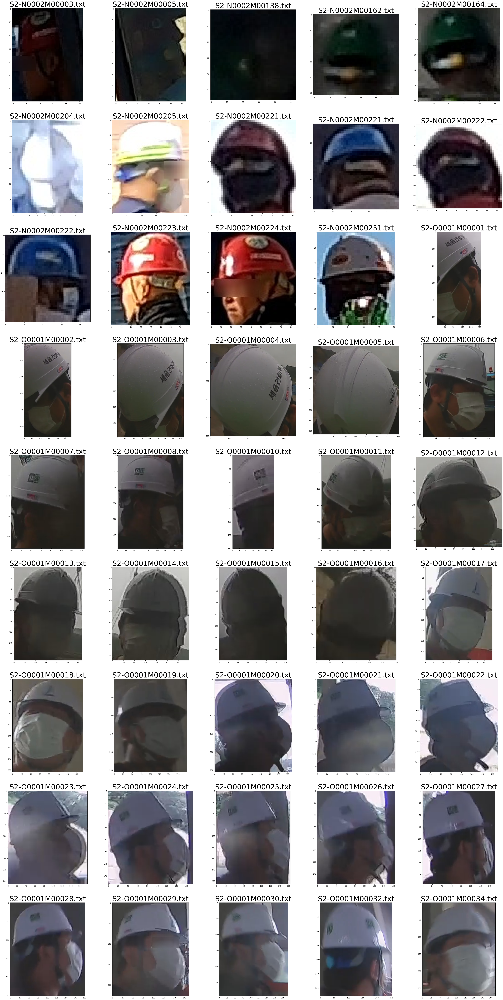

In [234]:
# image view 
import matplotlib.pyplot as plt

alpha = 0
dir = '../../../datasets/aihub_safety/human_car_ver2/images/'
labdir = '../../../datasets/aihub_safety/human_car_ver2/labels/'
cls_num = 7



# images = df.loc[df.loc[:,'cls'] == cls_num,'path'].values

plt.figure(figsize=(50,100))

new_datas = []
for num in range(45):
    plt.subplot(9,5,num+1)
    plt.title(labels[num+alpha],fontdict = {'fontsize' : 40})
    
    tmp_img = cv2.imread(dir + labels[num + alpha][:-4] + '.jpg')[...,::-1]
    with open(labdir + labels[num + alpha] , 'r') as f:
        datas = f.readlines()

    if num + alpha != 0:
        if (labels[num + alpha] != labels[num + alpha-1]):
            for i in datas:
                if i.split(' ')[0] == str(cls_num-1):
                    # print(i.strip())
                    new_datas.append([float(j) for j in i.strip().split(' ')[1:]])
    else:
        for i in datas:
            if i.split(' ')[0] == str(cls_num-1):
                # print(i.strip().split(' ')[1:])
                new_datas.append([float(j) for j in i.strip().split(' ')[1:]])
    
    # print(new_datas[num+alpha])
    xyxy = xywh2xyxy(new_datas[num],tmp_img.shape[1],tmp_img.shape[0])
    # print(xyxy[1],xyxy[3],xyxy[0],xyxy[2])
    boxed_img = tmp_img[xyxy[1]:xyxy[3],xyxy[0]:xyxy[2]]
    plt.imshow(boxed_img)



In [121]:
labels

array(['S2-N0002M00003.txt', 'S2-N0002M00005.txt', 'S2-N0002M00138.txt',
       'S2-N0002M00162.txt', 'S2-N0002M00164.txt', 'S2-N0002M00204.txt',
       'S2-N0002M00205.txt', 'S2-N0002M00221.txt', 'S2-N0002M00221.txt',
       'S2-N0002M00222.txt', 'S2-N0002M00222.txt', 'S2-N0002M00223.txt',
       'S2-N0002M00224.txt', 'S2-N0002M00251.txt', 'S2-O0001M00001.txt',
       'S2-O0001M00002.txt', 'S2-O0001M00003.txt', 'S2-O0001M00004.txt',
       'S2-O0001M00005.txt', 'S2-O0001M00006.txt', 'S2-O0001M00007.txt',
       'S2-O0001M00008.txt', 'S2-O0001M00010.txt', 'S2-O0001M00011.txt',
       'S2-O0001M00012.txt', 'S2-O0001M00013.txt', 'S2-O0001M00014.txt',
       'S2-O0001M00015.txt', 'S2-O0001M00016.txt', 'S2-O0001M00017.txt',
       'S2-O0001M00018.txt', 'S2-O0001M00019.txt', 'S2-O0001M00020.txt',
       'S2-O0001M00021.txt', 'S2-O0001M00022.txt', 'S2-O0001M00023.txt',
       'S2-O0001M00024.txt', 'S2-O0001M00025.txt', 'S2-O0001M00026.txt',
       'S2-O0001M00027.txt', 'S2-O0001M00028.txt', 

In [ ]:
# checking_list : [cls_num, folder_name, all_labeling_count, checking_labeling_count, good_labeling_count ,mislabeling_count, ratio, confidence level, sampling error]



In [107]:
clscount = { i+1 : 0 for i in range(19)}

for i in range(19):
    clscount[i+1] += len(df.loc[df.loc[:,'cls'] == i+1])

In [108]:
clscount

{1: 1089952,
 2: 664783,
 3: 0,
 4: 181075,
 5: 1091137,
 6: 109550,
 7: 1116516,
 8: 222157,
 9: 68943,
 10: 90699,
 11: 92745,
 12: 22672,
 13: 15272,
 14: 4236,
 15: 15928,
 16: 59649,
 17: 300459,
 18: 60792,
 19: 10185}

In [176]:
df.loc[df.loc[:,'cls'] == 4,'path'][:45].values


/tmp/ipykernel_81180/559378467.py:1: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  df.loc[df.loc[:,'cls'] == 4,'path'][:45].values


array(['S2-N0509M55455.txt', 'S2-N0509M55455.txt', 'S2-N0305M23721.txt',
       'S2-N0508M02023.txt', 'S2-N0509M12062.txt', 'S2-N0109M38711.txt',
       'S2-N0109M38711.txt', 'S2-N0509M62466.txt', 'S2-N2104M21217.txt',
       'S2-N0109M10574.txt', 'S2-N0109M10574.txt', 'S2-N1106M27516.txt',
       'S2-N0509M63597.txt', 'S2-N0510M01749.txt', 'S2-N0509M06530.txt',
       'S2-N0508M48994.txt', 'S2-N0508M48994.txt', 'S2-N2104M05102.txt',
       'S2-N0508M10720.txt', 'S2-N2104M51828.txt', 'S2-N0110M08909.txt',
       'S2-N0510M24164.txt', 'S2-N2104M51244.txt', 'S2-N2104M51244.txt',
       'S2-N0509M52039.txt', 'S2-N0509M52039.txt', 'S2-N0509M54364.txt',
       'S2-N0508M52864.txt', 'S2-N0508M52864.txt', 'S2-N0509M25784.txt',
       'S2-N2102M05223.txt', 'S2-N2102M21968.txt', 'S2-N0109M37736.txt',
       'S2-N0305M33000.txt', 'S2-N0109M20831.txt', 'S2-N0508M07443.txt',
       'S2-N0508M07443.txt', 'S2-N0508M07443.txt', 'S2-N0508M07443.txt',
       'S2-N0110M03274.txt', 'S2-N0108M02878.txt', 

In [185]:
df.loc[df.loc[:,'cls'] == 4,'path'].values

array(['S2-N0509M55455.txt', 'S2-N0509M55455.txt', 'S2-N0305M23721.txt',
       ..., 'S2-N0108M10901.txt', 'S2-N0110M01208.txt',
       'S2-N0508M17283.txt'], dtype=object)

In [205]:
checking_df

,cls,path,resolution,width,height,wperh,origin_path
3381270,7,S2-N1901M00002.txt,79,68,91,0.747253,[라벨]1.공동주택/서대문
3381269,7,S2-N1901M00002.txt,69,62,77,0.805195,[라벨]1.공동주택/서대문
3168012,7,S2-N1901M00003.txt,86,70,105,0.666667,[라벨]1.공동주택/서대문
3168013,7,S2-N1901M00003.txt,110,99,123,0.804878,[라벨]1.공동주택/서대문
3810697,7,S2-N1901M00004.txt,83,71,97,0.731959,[라벨]1.공동주택/서대문
...,...,...,...,...,...,...,...
4165082,7,S2-N1901M65862.txt,80,67,96,0.697917,[라벨]1.공동주택/서대문
3462143,7,S2-N1901M65865.txt,69,81,58,1.396552,[라벨]1.공동주택/서대문
3308548,7,S2-N1901M65866.txt,108,97,120,0.808333,[라벨]1.공동주택/서대문
3706991,7,S2-N1901M65867.txt,100,85,118,0.720339,[라벨]1.공동주택/서대문


In [151]:
checking_df.loc[:,'path'].values[20]

'S2-O0001M00007.txt'

In [165]:
from PIL import Image
import math

In [246]:
alpha = 0

dir = '../../../datasets/aihub_safety/human_car_ver2/images/'
labdir = '../../../datasets/aihub_safety/human_car_ver2/labels/'

all_count = 0
cls_num = 8
nameboxes = []
boxes = []

for i in range(1000):
    filename = checking_df.loc[:,'path'].values[i]
    # print(all_count)
    # print(filename)
    ratio = round(checking_df.loc[:,'wperh'].values[i],3)

    with open(labdir + filename, 'r') as f:
        datas = f.readlines()
    
    tmp_img = Image.open(dir + filename[:-4] + '.jpg')
    
    w, h =  tmp_img.size[0], tmp_img.size[1]
    
    tmp_img = cv2.imread(dir + filename[:-4] + '.jpg')[...,::-1]

    for data in datas:
        xywh = data.strip().split(' ')[1:]

        # xywh = [float(i) for i in xywh]
        # xyxy = xywh2xyxy(xywh,tmp_img.shape[1],tmp_img.shape[0], rounding = True)
        xyxy = xywh2xyxy(xywh, w, h)

        # xyxy = xywh2xyxy(box, img.size[0], img.size[1])

        # boxed_img = img.crop((xyxy[0],xyxy[1],xyxy[2],xyxy[3]))

        width = xyxy[2] - xyxy[0]  + 1 # boxed img width, height
        height = xyxy[3] - xyxy[1] + 1

        # w_perh = width / height
        
        lab_ratio = round(width / height,3)
        # print(ratio, lab_ratio)
        
        if (data.strip().split(' ')[0] == str(cls_num-1)) and (abs((ratio- lab_ratio) /lab_ratio)  < 0.01):

            all_count += 1 
            nflu = data.strip().split(' ')[1:]
            # nflu = [float(o) for o in data.strip().split(' ')[1:]]
            xyxy = xywh2xyxy(nflu,w,h)
            # boxed_img = tmp_img[xyxy[1]:xyxy[3],xyxy[0]:xyxy[2]]
            boxed_img = tmp_img[xyxy[1]:xyxy[3],xyxy[0]:xyxy[2]]
            nameboxes.append(filename)
            boxes.append(boxed_img)
    
    if all_count == 1050:
        break

# 일단 isolationforest 로 하면 단점이 이상치 안 범주도 비정상으로 잡힌다는 것이다. 
# 걍 ratio 만으로 할거면 5% 정도 이상치 제거만 하면 될 듯
# import random
# random_indice = list(range(len(nameboxes)))
# random.seed(42)
# random.shuffle(random_indice)

# plt.figure(figsize=(50,100))
# for num in range(45):
#     plt.subplot(9,5,num+1)
#     plt.title(nameboxes[random_indice[num+alpha]],fontdict = {'fontsize' : 40})
#     plt.imshow(boxes[random_indice[num+alpha]])

In [258]:
df.to_csv(encoding='utf-8',path_or_buf= './df_files/df.csv')

In [252]:
nohat_df = df.loc[df.loc[:,'cls'] == 8].reset_index(drop=True)

In [259]:
nohat_df.to_csv(encoding='utf-8',path_or_buf= './df_files/nohat_df.csv')

In [253]:
nohat_df

,cls,path,resolution,width,height,wperh,origin_path
0,8,S2-N0508M47833.txt,45,41,50,0.820000,[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사
1,8,S2-N0508M47833.txt,73,63,84,0.750000,[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사
2,8,S2-N0508M47833.txt,58,51,65,0.784615,[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사
3,8,S2-N0508M47833.txt,38,35,42,0.833333,[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사
4,8,S2-N0508M47833.txt,37,32,42,0.761905,[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사
...,...,...,...,...,...,...,...
222152,8,S2-N2101M33163.txt,70,64,77,0.831169,[라벨]10.주차장/고양스타필드
222153,8,S2-N2101M33163.txt,90,81,101,0.801980,[라벨]10.주차장/고양스타필드
222154,8,S2-N0508M17283.txt,129,124,134,0.925373,[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사
222155,8,S2-N0508M17283.txt,99,90,108,0.833333,[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사


In [254]:
a = set()

for i in range(len(nohat_df)):
    if len(a) == 1000:
        break
    a.add(nohat_df.loc[i,'path'])

In [256]:
import shutil
for i in list(a):
    shutil.copy('../../../datasets/aihub_safety/human_car_ver2/images/' + i[:-4] + '.jpg', '../../../temp/yolov7/test_images/no_hat/')


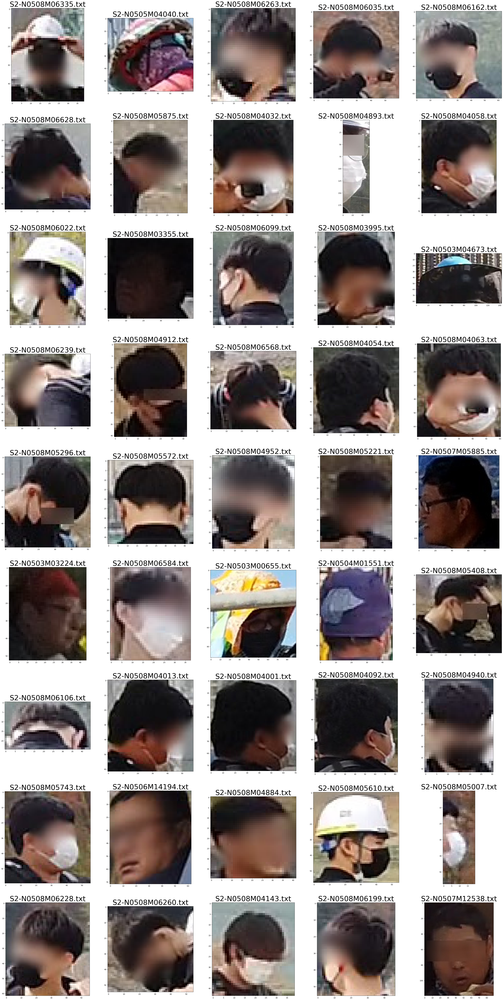

In [248]:
import random

alpha = 45* 1


random_indice = list(range(len(nameboxes)))
random.seed(42)
random.shuffle(random_indice)

plt.figure(figsize=(50,100))
for num in range(45):
    plt.subplot(9,5,num+1)
    plt.title(nameboxes[random_indice[num+alpha]],fontdict = {'fontsize' : 40})
    plt.imshow(boxes[random_indice[num+alpha]])

In [194]:
random_indice

[41,
 131,
 92,
 51,
 60,
 139,
 78,
 64,
 115,
 39,
 107,
 66,
 67,
 42,
 128,
 30,
 135,
 72,
 86,
 38,
 127,
 1,
 74,
 96,
 32,
 120,
 132,
 102,
 119,
 18,
 121,
 106,
 56,
 126,
 81,
 16,
 65,
 61,
 71,
 63,
 110,
 123,
 36,
 113,
 4,
 129,
 25,
 122,
 2,
 130,
 3,
 52,
 49,
 88,
 104,
 14,
 125,
 98,
 40,
 17,
 82,
 76,
 105,
 31,
 21,
 9,
 34,
 136,
 99,
 47,
 112,
 84,
 94,
 134,
 90,
 100,
 85,
 116,
 87,
 29,
 95,
 133,
 24,
 73,
 46,
 79,
 80,
 37,
 140,
 10,
 101,
 15,
 68,
 58,
 93,
 5,
 33,
 77,
 44,
 45,
 12,
 48,
 11,
 13,
 109,
 114,
 27,
 19,
 118,
 43,
 54,
 124,
 20,
 117,
 97,
 0,
 111,
 103,
 137,
 75,
 138,
 28,
 53,
 69,
 89,
 83,
 91,
 50,
 6,
 59,
 55,
 23,
 7,
 8,
 108,
 22,
 26,
 35,
 57,
 62,
 70]

In [141]:
from glob import glob

lab1 = glob('../../../datasets/aihub_safety/train/*/*/S2-N0508M47833.json')
lab2 = glob('../../../datasets/aihub_safety/train/*/*/*/S2-N0508M47833.json')

lab = lab1+ lab2
lab

['../../../datasets/aihub_safety/train/[라벨]1.공동주택/하남감일 A-7BL 11공구 아파트 신축공사/5.전체/S2-N0508M47833.json']

In [118]:
cv2.imread(dir + images[num + alpha][:-4] + '.jpg')

'../../../datasets/aihub_safety/human_car_ver2/images/S2-N0508M47833.jpg'

In [191]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set_style("darkgrid")
from sklearn.ensemble import IsolationForest

In [268]:
model = IsolationForest(contamination=0.05)

In [269]:
df.loc[df.loc[:,'cls'] == 7].iloc[:,2:]

,resolution,width,height,wperh
3136497,204,186,223,0.834081
3136498,112,98,129,0.759690
3136499,98,91,106,0.858491
3136500,56,55,58,0.948276
3136501,82,80,85,0.941176
...,...,...,...,...
4253008,88,82,94,0.872340
4253009,118,115,122,0.942623
4253010,79,69,91,0.758242
4253011,89,88,91,0.967033


In [270]:

model.fit(df.loc[df.loc[:,'cls'] == 7].iloc[:,-1:])

/home/tekim/haha/lib/python3.9/site-packages/sklearn/base.py:409: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


IsolationForest(contamination=0.05)

In [271]:
pred = model.predict(df.loc[df.loc[:,'cls'] == 7].iloc[:,-1:])

(array([  55489.,       0.,       0.,       0.,       0.,       0.,
              0.,       0.,       0., 1061027.]),
 array([-1. , -0.8, -0.6, -0.4, -0.2,  0. ,  0.2,  0.4,  0.6,  0.8,  1. ]),
 <BarContainer object of 10 artists>)

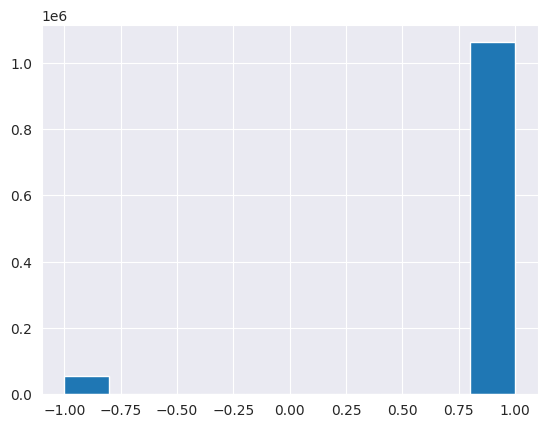

In [272]:
plt.hist(pred)

In [273]:
temp_df = df.loc[df.loc[:,'cls'] == 7].iloc[:,:]

In [274]:
temp_df.reset_index(drop=True, inplace=True)

In [275]:
temp_df.loc[:,'pred'] = pred

/tmp/ipykernel_81180/2147457630.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_df.loc[:,'pred'] = pred


In [276]:
temp_df

,cls,path,resolution,width,height,wperh,pred
0,7,S2-N1901M18386.txt,204,186,223,0.834081,1
1,7,S2-N0508M36428.txt,112,98,129,0.759690,1
2,7,S2-N0508M36428.txt,98,91,106,0.858491,1
3,7,S2-N0509M55455.txt,56,55,58,0.948276,1
4,7,S2-N0509M55455.txt,82,80,85,0.941176,1
...,...,...,...,...,...,...,...
1116511,7,S2-N0108M08366.txt,88,82,94,0.872340,1
1116512,7,S2-N0108M08366.txt,118,115,122,0.942623,1
1116513,7,S2-N0304M01247.txt,79,69,91,0.758242,1
1116514,7,S2-N0304M01247.txt,89,88,91,0.967033,1


In [283]:
temp_df.describe()

,cls,resolution,width,height,wperh,pred
count,1116516.0,1.116516e+06,1.116516e+06,1.116516e+06,1.116516e+06,1.116516e+06
mean,7.0,9.541908e+01,8.872138e+01,1.036380e+02,8.690125e-01,9.006033e-01
std,0.0,6.342712e+01,6.051889e+01,6.976380e+01,1.599486e-01,4.346422e-01
min,7.0,7.000000e+00,1.000000e+00,8.000000e+00,1.818182e-02,-1.000000e+00
25%,7.0,5.800000e+01,5.400000e+01,6.300000e+01,7.833333e-01,1.000000e+00
50%,7.0,7.800000e+01,7.200000e+01,8.400000e+01,8.541667e-01,1.000000e+00
75%,7.0,1.100000e+02,1.020000e+02,1.190000e+02,9.333333e-01,1.000000e+00
max,7.0,1.269000e+03,1.460000e+03,1.355000e+03,1.290000e+01,1.000000e+00


In [287]:
temp_df.loc[temp_df.loc[:,'wperh'] >=1.2].count

<bound method DataFrame.count of          cls                path  resolution  width  height     wperh  pred
31         7  S2-N0509M51700.txt          92    104      81  1.283951    -1
32         7  S2-N0509M51700.txt          89     98      80  1.225000    -1
44         7  S2-N2001M16746.txt         385    449     330  1.360606    -1
103        7  S2-N2401M02395.txt         194    227     166  1.367470    -1
124        7  S2-N2104M51828.txt         730    817     652  1.253067    -1
...      ...                 ...         ...    ...     ...       ...   ...
1116306    7  S2-N1106M15733.txt          75     93      61  1.524590    -1
1116371    7  S2-N0305M31591.txt         197    265     147  1.802721    -1
1116455    7  S2-N0509M31643.txt          70     77      63  1.222222    -1
1116461    7  S2-N1106M16232.txt          60     82      44  1.863636    -1
1116471    7  S2-N0508M21035.txt          37     48      29  1.655172    -1

[27841 rows x 7 columns]>

In [302]:
type(temp_df.loc[temp_df.loc[:,'wperh'] <=0.63])

pandas.core.frame.DataFrame

In [304]:
strange_df = pd.concat([temp_df.loc[temp_df.loc[:,'wperh'] <=0.63], temp_df.loc[temp_df.loc[:,'wperh'] >=1.2]])

In [305]:
strange_df

,cls,path,resolution,width,height,wperh,pred
15,7,S2-N0509M12062.txt,53,39,73,0.534247,-1
18,7,S2-O0103M02199.txt,186,133,261,0.509579,-1
80,7,S2-N0510M01749.txt,79,41,153,0.267974,-1
107,7,S2-N0506M11048.txt,68,52,89,0.584270,-1
137,7,S2-N0508M35621.txt,374,265,529,0.500945,-1
...,...,...,...,...,...,...,...
1116306,7,S2-N1106M15733.txt,75,93,61,1.524590,-1
1116371,7,S2-N0305M31591.txt,197,265,147,1.802721,-1
1116455,7,S2-N0509M31643.txt,70,77,63,1.222222,-1
1116461,7,S2-N1106M16232.txt,60,82,44,1.863636,-1


In [277]:
len(temp_df)

1116516

In [278]:
pred_temp_df = temp_df.loc[temp_df.loc[:,'pred'] == -1]

In [279]:
len(pred_temp_df)

55489

In [280]:
pred_temp_df.iloc[:10,:]

,cls,path,resolution,width,height,wperh,pred
15,7,S2-N0509M12062.txt,53,39,73,0.534247,-1
18,7,S2-O0103M02199.txt,186,133,261,0.509579,-1
19,7,S2-N0506M11922.txt,62,67,57,1.175439,-1
31,7,S2-N0509M51700.txt,92,104,81,1.283951,-1
32,7,S2-N0509M51700.txt,89,98,80,1.225000,-1
44,7,S2-N2001M16746.txt,385,449,330,1.360606,-1
80,7,S2-N0510M01749.txt,79,41,153,0.267974,-1
103,7,S2-N2401M02395.txt,194,227,166,1.367470,-1
107,7,S2-N0506M11048.txt,68,52,89,0.584270,-1
114,7,S2-N0304M34732.txt,69,75,64,1.171875,-1


In [281]:
all_count = 0
cls_num = 7
nameboxes = []
boxes = []

for i in range(1000):
    filename = pred_temp_df.loc[:,'path'].values[i]
    with open(labdir + filename, 'r') as f:
        datas = f.readlines()
    
    tmp_img = cv2.imread(dir + filename[:-4] + '.jpg')[...,::-1]
    for data in datas:
        if data.strip().split(' ')[0] == str(cls_num-1):
            all_count += 1 
            # print(data.strip().split(' ')[1:])
            nflu = [float(o) for o in data.strip().split(' ')[1:]]
            xyxy = xywh2xyxy(nflu,tmp_img.shape[1],tmp_img.shape[0])
            boxed_img = tmp_img[xyxy[1]:xyxy[3],xyxy[0]:xyxy[2]]
            nameboxes.append(filename)
            boxes.append(boxed_img)
    
    if all_count ==45:
        break

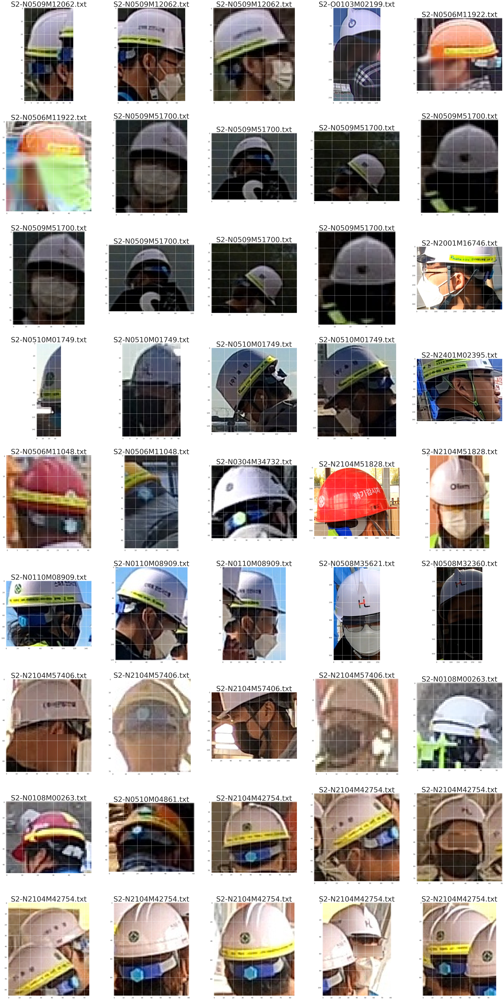

In [282]:
# 일단 isolationforest 로 하면 단점이 이상치 안 범주도 비정상으로 잡힌다는 것이다. 
# 걍 ratio 만으로 할거면 5% 정도 이상치 제거만 하면 될 듯



plt.figure(figsize=(50,100))
for num in range(45):
    plt.subplot(9,5,num+1)
    plt.title(nameboxes[num],fontdict = {'fontsize' : 40})
    plt.imshow(boxes[num])
    

In [307]:
pred_temp_df.loc[:,'path'].values[i]

'S2-N0509M51397.txt'

IndexError: list index out of range

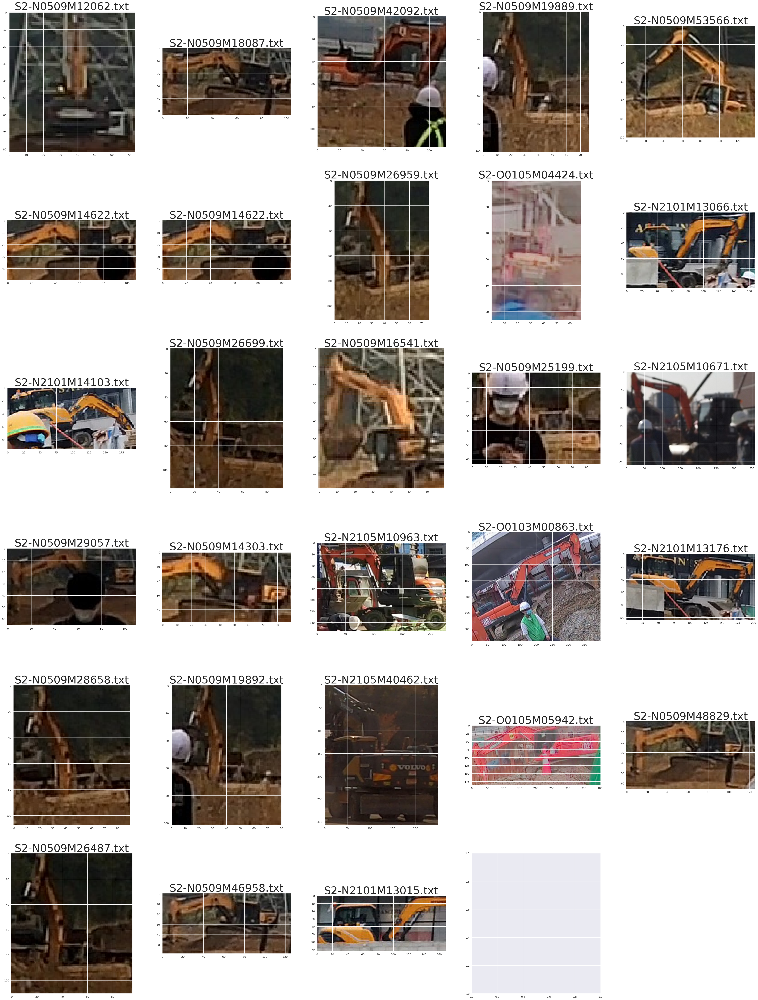

In [331]:
all_count = 0
cls_num = 9
nameboxes = []
boxes = []

for i in range(1000):
    filename = pred_temp_df.loc[:,'path'].values[i]
    with open(labdir + filename, 'r') as f:
        datas = f.readlines()
    
    tmp_img = cv2.imread(dir + filename[:-4] + '.jpg')[...,::-1]
    for data in datas:
        if data.strip().split(' ')[0] == str(cls_num-1):
            all_count += 1 
            # print(data.strip().split(' ')[1:])
            nflu = [float(o) for o in data.strip().split(' ')[1:]]
            xyxy = xywh2xyxy(nflu,tmp_img.shape[1],tmp_img.shape[0])
            boxed_img = tmp_img[xyxy[1]:xyxy[3],xyxy[0]:xyxy[2]]
            nameboxes.append(filename)
            boxes.append(boxed_img)
    
    if all_count ==45:
        break
# 일단 isolationforest 로 하면 단점이 이상치 안 범주도 비정상으로 잡힌다는 것이다. 
# 걍 ratio 만으로 할거면 5% 정도 이상치 제거만 하면 될 듯



plt.figure(figsize=(50,100))
for num in range(45):
    plt.subplot(9,5,num+1)
    plt.title(nameboxes[num],fontdict = {'fontsize' : 40})
    plt.imshow(boxes[num])
    

In [309]:
strange_df.loc[:,'path'].va

15         S2-N0509M12062.txt
18         S2-O0103M02199.txt
80         S2-N0510M01749.txt
107        S2-N0506M11048.txt
137        S2-N0508M35621.txt
                  ...        
1116306    S2-N1106M15733.txt
1116371    S2-N0305M31591.txt
1116455    S2-N0509M31643.txt
1116461    S2-N1106M16232.txt
1116471    S2-N0508M21035.txt
Name: path, Length: 52760, dtype: object

In [310]:
strange_df

,cls,path,resolution,width,height,wperh,pred
15,7,S2-N0509M12062.txt,53,39,73,0.534247,-1
18,7,S2-O0103M02199.txt,186,133,261,0.509579,-1
80,7,S2-N0510M01749.txt,79,41,153,0.267974,-1
107,7,S2-N0506M11048.txt,68,52,89,0.584270,-1
137,7,S2-N0508M35621.txt,374,265,529,0.500945,-1
...,...,...,...,...,...,...,...
1116306,7,S2-N1106M15733.txt,75,93,61,1.524590,-1
1116371,7,S2-N0305M31591.txt,197,265,147,1.802721,-1
1116455,7,S2-N0509M31643.txt,70,77,63,1.222222,-1
1116461,7,S2-N1106M16232.txt,60,82,44,1.863636,-1


In [317]:
strange_df

,cls,path,resolution,width,height,wperh,pred
15,7,S2-N0509M12062.txt,53,39,73,0.534247,-1
18,7,S2-O0103M02199.txt,186,133,261,0.509579,-1
80,7,S2-N0510M01749.txt,79,41,153,0.267974,-1
107,7,S2-N0506M11048.txt,68,52,89,0.584270,-1
137,7,S2-N0508M35621.txt,374,265,529,0.500945,-1
...,...,...,...,...,...,...,...
1116306,7,S2-N1106M15733.txt,75,93,61,1.524590,-1
1116371,7,S2-N0305M31591.txt,197,265,147,1.802721,-1
1116455,7,S2-N0509M31643.txt,70,77,63,1.222222,-1
1116461,7,S2-N1106M16232.txt,60,82,44,1.863636,-1


In [322]:
def xywh2xyxy(xywh,w,h, rounding = True):
    xywh = [float(i) for i in xywh]

    if rounding:
        xyxy = [round((xywh[0] - xywh[2]/2) * w),round((xywh[1] - xywh[3]/2) * h),round((xywh[0] + xywh[2]/2) * w),round((xywh[1] + xywh[3]/2) * h)]
        if xyxy[0] > xyxy[2]:
            temp = xyxy[0]
            xyxy[0] = xyxy[2]
            xyxy[2] = temp
        if xyxy[1] > xyxy[3]:
            temp = xyxy[1]
            xyxy[1] = xyxy[3]
            xyxy[1] = temp
        return xyxy
    else:
        return [(xywh[0] - xywh[2]/2) * w ,(xywh[1] - xywh[3]/2) * h ,(xywh[0] + xywh[2]/2) * w ,(xywh[1] + xywh[3]/2) * h]

In [323]:
import math

IndexError: list index out of range

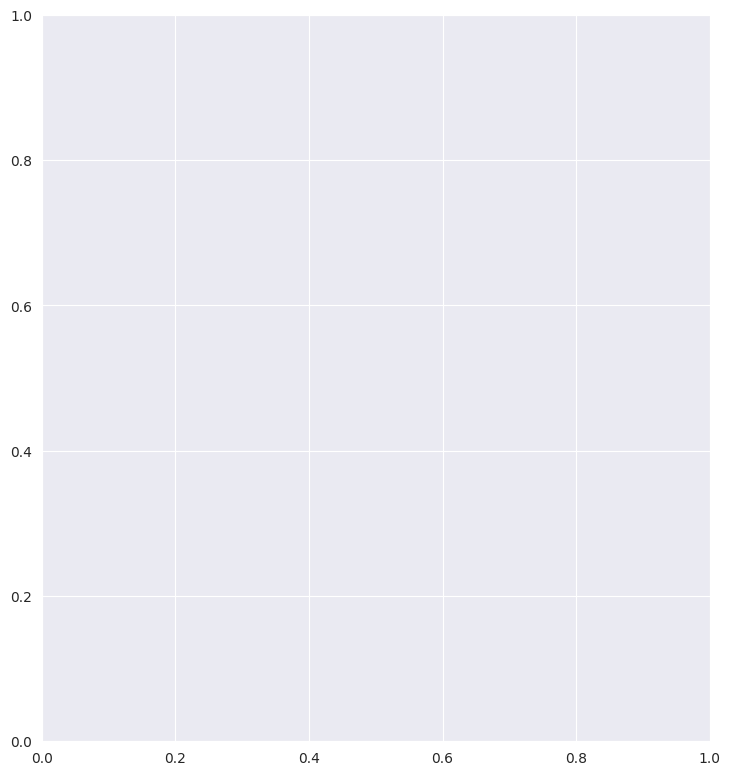

In [329]:
all_count = 0
cls_num = 7
nameboxes = []
boxes = []

for i in range(1000):
    filename = strange_df.loc[:,'path'].values[i]
    ratio = round(strange_df.loc[:,'wperh'].values[i],3)

    with open(labdir + filename, 'r') as f:
        datas = f.readlines()
    
    tmp_img = cv2.imread(dir + filename[:-4] + '.jpg')[...,::-1]
    


    for data in datas:
        xywh = data.strip().split(' ')[1:]
        xywh = [float(i) for i in xywh]
        xyxy = xywh2xyxy(xywh,tmp_img.shape[1],tmp_img.shape[0], rounding = True)

        width = xyxy[2] - xyxy[0] + 1 # boxed img width, height
        height = xyxy[3] - xyxy[1] + 1 

        lab_ratio = round(width / height,3)



        if (data.strip().split(' ')[0] == str(cls_num-1)) and (ratio == lab_ratio):

            print(filename)
            print(ratio, lab_ratio)


            all_count += 1 
            # print(data.strip().split(' ')[1:])
            nflu = [float(o) for o in data.strip().split(' ')[1:]]
            xyxy = xywh2xyxy(nflu,tmp_img.shape[1],tmp_img.shape[0])
            boxed_img = tmp_img[xyxy[1]:xyxy[3],xyxy[0]:xyxy[2]]
            nameboxes.append(filename)
            boxes.append(boxed_img)
    
    if all_count ==135:
        break
# 일단 isolationforest 로 하면 단점이 이상치 안 범주도 비정상으로 잡힌다는 것이다. 
# 걍 ratio 만으로 할거면 5% 정도 이상치 제거만 하면 될 듯


alpha = 90
plt.figure(figsize=(50,100))
for num in range(45):
    plt.subplot(9,5,num+1)
    plt.title(nameboxes[num+alpha],fontdict = {'fontsize' : 40})
    plt.imshow(boxes[num+alpha])
    

In [313]:
round(0.83123124,3)

0.831

2
1
4
1
1
3
2
4
1
2
1
1
2
2
1
2
3
1
1
3
4
3
1
4
5
1
2
1
2
2
4
4
1
1
1
2
2
2
4


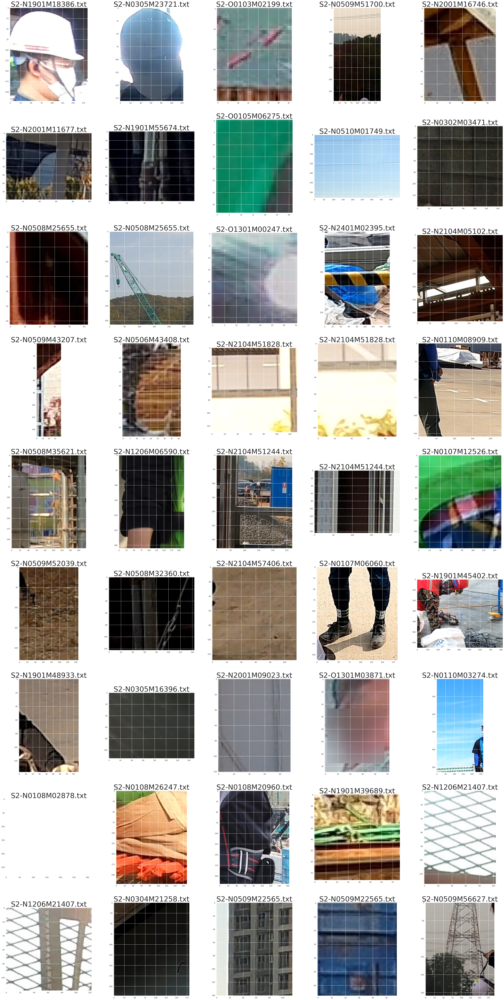

In [221]:
alpha = 0
dir = '../../../datasets/aihub_safety/human_car_ver2/images/'
labdir = '../../../datasets/aihub_safety/human_car_ver2/labels/'
cls_num = 7

# images = df.loc[df.loc[:,'cls'] == cls_num,'path'].values
images = pred_temp_df.loc[:,'path'].values
plt.figure(figsize=(50,100))
new_datas = []
for num in range(45):
    plt.subplot(9,5,num+1)
    plt.title(images[num+alpha],fontdict = {'fontsize' : 40})
    
    tmp_img = cv2.imread(dir + images[num + alpha][:-4] + '.jpg')[...,::-1]
    with open(labdir + images[num + alpha] , 'r') as f:
        datas = f.readlines()

    if num + alpha != 0:
        if (images[num] != images[num-1]):
            sum = 0
            for i in datas:
                if i.split(' ')[0] == str(cls_num-1):
                    sum +=1
                    # print(i.strip())
                    new_datas.append([float(j) for j in i.strip().split(' ')[1:]])
            print
    else:
        for i in datas:
            if i.split(' ')[0] == str(cls_num-1):
                # print(i.strip().split(' ')[1:])
                new_datas.append([float(j) for j in i.strip().split(' ')[1:]])
    
    # print(new_datas[num+alpha])
    xyxy = xywh2xyxy(new_datas[num],tmp_img.shape[1],tmp_img.shape[0])
    # print(xyxy[1],xyxy[3],xyxy[0],xyxy[2])
    boxed_img = tmp_img[xyxy[1]:xyxy[3],xyxy[0]:xyxy[2]]
    plt.imshow(boxed_img)


In [115]:
images[0]

'S2-N0508M47833.txt'

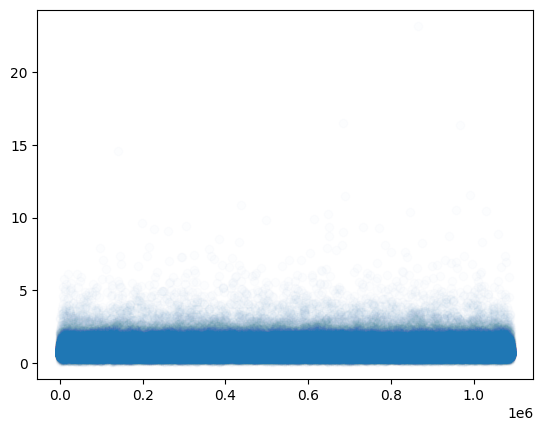

In [42]:

plt.scatter( x=range(len(df.loc[df.loc[:,'cls'] == 1,'wperh'])),y=df.loc[df.loc[:,'cls'] == 1,'wperh'],alpha=0.01)

In [45]:
df.loc[df.loc[:,'cls'] == 1,'wperh'] * 100

0          58.823529
1          81.333333
2          40.000000
3          51.562500
4          42.767296
             ...    
1089947    73.384030
1089948    44.444444
1089949    48.874598
1089950    80.155642
1089951    90.322581
Name: wperh, Length: 1089952, dtype: float64

(array([2.0000e+00, 0.0000e+00, 9.0000e+00, 9.0000e+00, 4.0000e+01,
        6.2000e+01, 1.1100e+02, 1.4400e+02, 2.4900e+02, 3.3200e+02,
        4.2700e+02, 5.5700e+02, 6.0000e+02, 6.8900e+02, 7.6500e+02,
        7.8800e+02, 8.8200e+02, 9.0900e+02, 9.4200e+02, 9.7100e+02,
        1.0420e+03, 1.1290e+03, 1.2690e+03, 1.3500e+03, 1.4920e+03,
        1.8950e+03, 2.4310e+03, 3.4080e+03, 5.4960e+03, 9.6630e+03,
        1.6024e+04, 2.6544e+04, 3.8652e+04, 5.1346e+04, 6.2868e+04,
        7.3681e+04, 8.2901e+04, 8.7745e+04, 8.7314e+04, 8.4725e+04,
        7.9203e+04, 6.8938e+04, 6.0574e+04, 4.8630e+04, 4.1358e+04,
        3.3303e+04, 2.3683e+04, 2.0252e+04, 1.6126e+04, 1.2685e+04,
        1.0050e+04, 8.2340e+03, 6.6190e+03, 5.1910e+03, 4.3560e+03,
        3.7340e+03, 2.9440e+03, 2.5100e+03, 2.1000e+03, 1.7380e+03,
        1.5430e+03, 1.3440e+03, 1.1790e+03, 1.0000e+03, 8.4700e+02,
        7.6300e+02, 6.2700e+02, 6.0600e+02, 4.5500e+02, 5.8300e+02,
        4.6000e+02, 3.8600e+02, 3.4500e+02, 3.47

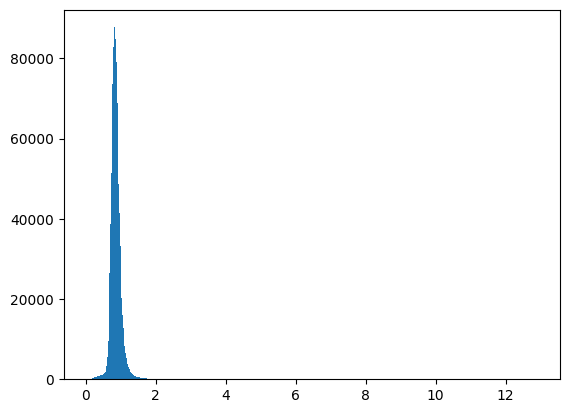

In [102]:
plt.hist(df.loc[df.loc[:,'cls'] == 7,'wperh'],bins=600) 

{'whiskers': [<matplotlib.lines.Line2D at 0x7f0ce0f93a60>,
 'caps': [<matplotlib.lines.Line2D at 0x7f0ce0fa1100>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f0ce0f93790>],
 'medians': [<matplotlib.lines.Line2D at 0x7f0ce0fa15e0>],
 'fliers': [<matplotlib.lines.Line2D at 0x7f0ce0fa18b0>],
 'means': []}

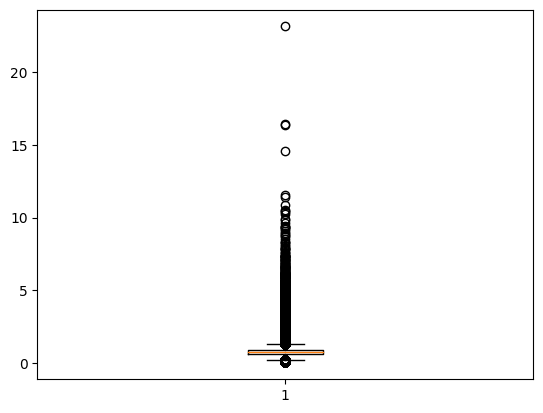

In [53]:
plt.boxplot(df.loc[df.loc[:,'cls'] == 1,'wperh'])

In [62]:
from scipy.stats import shapiro

In [98]:
# 라이브러리 호출
import numpy as np
from scipy.stats import shapiro

# 정규분포를 따르도록 랜덤하게 값을 부여
np.random.seed(0)
n = 5000
# x1 = np.random.normal(0, 100, n)
x1 = np.array(df.loc[df.loc[:,'cls'] == 1,'wperh'][:1000])

shapiro_test = shapiro(x1)
shapiro_test

ShapiroResult(statistic=0.8422824740409851, pvalue=2.3132269330396637e-30)

In [83]:
np.random.normal(0, 100, n)

array([  30.97238249,  -73.74561939, -153.69198832, ...,   51.68721789,
         -3.29206931,  129.8111432 ])